# SCA
Uredjaji koji koriste enkripciju se oslanjaju na poznate i pouzdane kriptografske algoritme koji su matematicki sigurni. S druge strane, kriptografski algoritmi se cesto izvrsavaju na fizickim uredjajima, odnosno mikrokontrolerima i tada moze doci do "curenja" podataka. Naime prilikom izvrsavanja algoritma, mikrokontroler koristi razlicite kolicine elektricne energije u razlicitim fazama algoritma. Ove oscilacije u kolicini energije mogu se iskoristiti za otkrivanje skrivenih elemenata algoritma kao sto su kriptografski kljucevi. SCA ili side channel attack je jedan od nacina na koji se mogu napasti **implementacije** kriptografskih algoritama (ne sam dizajn algoritma, koji je, kako je vec pomenuto bezbedan). Postoji nekoliko vrsta "curenja" informacija: elektromagnetno zracenje, vreme potrebno za izvrsavanje koraka algoritma, utrosena elektricna energija, toplota ili zvuk. 

U zavisnosti od izvora "curenja" postoje razlicite vrste napada. Naime, ukoliko se kao izvor koristi izmerena struja, dve najkoriscenije vrste napada su SPA (Simple Power Analysis) koji predstavlja vizualno analiziranje grafova izmerene potrosnje struje i DPA (Differential Power Analysis) koji statistickim metodama ispituje izmerenu struju. Prednost DPA u odnosu na SPA je to sto ...
Simetricni algoritmi enkripcije koji su implementirani u hardveru su vecinom otporni na SPA.


**TODO:**
numpy
matplotlib

# Podaci

Kako su uredjaji koji implementiraju kriptografske algoritme sve prisutniji, tako je i njihova sigurnost sve kriticnija i samim tim postoji veliki broj istrazivanja u oblasti zastite od raznih vrsta napada. Istrazivaci sa xxx su iz ovog razloga napravili skup podataka koji bi ostalim istrazivacima omogucio dobar pocetak prilikom testiranja njihovih napada i zastita sistema. Za pocetak ce se u radu koristiti skup podataka iz SCAML tutoriala, a nakon toga ce biti testiran ucinak nad ASCAD skupom. Za testiranje same arhitekture neuronske mreze nije toliko bitno otkriti sve bajtove kljuca jer se rezultati obicno dobro generalizuju na ostale bajtove. Izmedju ostalog, to je jos jedan razlog zasto ASCAD koristi samo treci bajt kljuca kao referentnu vrednost. Ostali razlozi su izlistani u samom radu i imaju veze sa SNR itd.

In [ ]:
pip install h5py

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install numpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [11]:
!pip install keras-tuner

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 135 kB 5.0 MB/s 
     |████████████████████████████████| 1.6 MB 54.3 MB/s 


In [ ]:
import random
import matplotlib.pyplot as plt
from matplotlib.figure import Figure
import os
import numpy as np
import h5py
import tensorflow as tf
import keras
from datetime import datetime
import keras_tuner as kt
import tqdm

In [13]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
training_dataset_path = '/content/drive/MyDrive/datasets/tinyaes/train'

shard_array = []

for shard_path in os.listdir(training_dataset_path):
  shard_array.append(np.load(training_dataset_path + '/' + shard_path))

Dataset consists of 256 "shards". Each "shard" is corresponding to one key. Within each shard, there are 256 plaintext-ciphertext pairs with appropriate intermediate values => 65.536 traces in total

Shard_0 structure:
```
key_0 - pt_0 - ct_0 - trace_0
key_0 - pt_1 - ct_1 - trace_1
.
.
.
key_0 - pt_256 - ct_256 - trace_256
```



In [ ]:
example_shard_index = random.randint(0, len(shard_array))

for f in shard_array[example_shard_index].files:
  print(f"Shape of {f} is {shard_array[example_shard_index][f].shape}")

# Resolution of the trace is 80.000 points
# Attack points (sub_bytes_in/_out, keys) are transposed:
# First row corresponds to the attack on the first key byte, 
# second row corresponds to the attack on the second key byte etc.
# Attack on each byte has 256 corresponding traces and 256

Shape of traces is (256, 80000, 1)
Shape of cts is (16, 256)
Shape of sub_bytes_out is (16, 256)
Shape of sub_bytes_in is (16, 256)
Shape of pts is (16, 256)
Shape of keys is (16, 256)


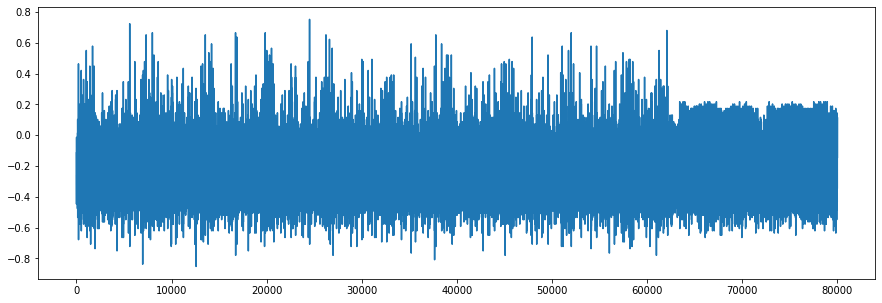

In [ ]:
# Plot one trace to see how it looks
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(15, 5))

plt.plot(shard_array[example_shard_index]['traces'][0])
plt.show()

Iz samog trace-a ne moze se puno zakljuciti, ne vide se jasno runde AES algoritma, jedino se na desnom kraju vidi kada se oscilacije smire i to moze ukazivati na kraj izvrsavanja kriptografskog algoritma. Moguce je da bi iskusniji istrazivac uvideo vise pravilnosti, ali sama ta cinjenica ukazuje da je analiza veoma slozena i iziskuje dosta vremena. Pristup resavanja ovog problema masinskim ucenjem nastoji da smanji vreme potrebno za analizu sigurnosti sistema.

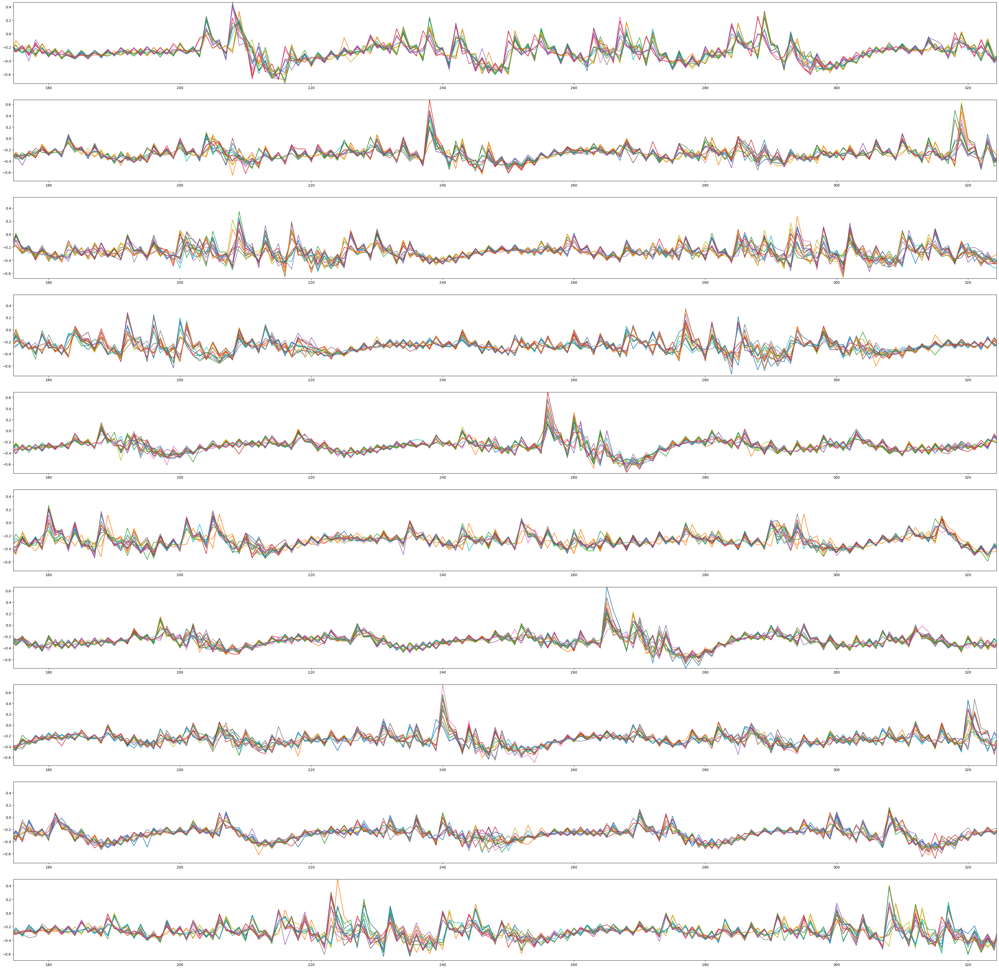

In [ ]:
from matplotlib.figure import Figure

fig = Figure(figsize=(50,50), dpi=100)

example_shard = shard_array[example_shard_index]

for i in range(10):
  ax = fig.add_subplot(10,1,i+1)
  ax.margins(x=-0.35, y=0)
  for j in range(15):
    ax.plot(example_shard['traces'][random.randint(0,255)][i*1000:i*1000+500])

display(fig)

Sa grafika se uocava nekoliko razlicitih regiona u kojima se potrosnja struje ne poklapa sto moze da ukazuje ili na šum ili na "curenje" podataka. Kada bismo koristili klasican DPA, ovde bismo izracunali proseke trace-ova koji u target bitu imaju 1 itd. onda bi se na diferencijalnom grafu videli siljci tamo gde se javlja "curenje". Nedostatak ovog pristupa je sto treba znati gde se tacno javljaju curenja, koji bitovi su odgovorni za curenje i sklono je ljudskoj gresci. Koriscenje masinskog ucenja za resenje ovog problema nastoji da resi ove probleme i unapredi tehnike istrazivanja sigurnosti uredjaja (a i softvera) koji se bave enkripcijom.

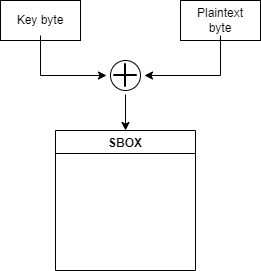

## AES

In [24]:
class AES():
  """! AES algorithm partial implementation
  Used for key recovery
  """

  AES_SBOX = [
    # 0    1    2    3    4    5    6    7    8    9    a    b    c    d    e    f 
    0x63,0x7c,0x77,0x7b,0xf2,0x6b,0x6f,0xc5,0x30,0x01,0x67,0x2b,0xfe,0xd7,0xab,0x76, # 0
    0xca,0x82,0xc9,0x7d,0xfa,0x59,0x47,0xf0,0xad,0xd4,0xa2,0xaf,0x9c,0xa4,0x72,0xc0, # 1
    0xb7,0xfd,0x93,0x26,0x36,0x3f,0xf7,0xcc,0x34,0xa5,0xe5,0xf1,0x71,0xd8,0x31,0x15, # 2
    0x04,0xc7,0x23,0xc3,0x18,0x96,0x05,0x9a,0x07,0x12,0x80,0xe2,0xeb,0x27,0xb2,0x75, # 3
    0x09,0x83,0x2c,0x1a,0x1b,0x6e,0x5a,0xa0,0x52,0x3b,0xd6,0xb3,0x29,0xe3,0x2f,0x84, # 4
    0x53,0xd1,0x00,0xed,0x20,0xfc,0xb1,0x5b,0x6a,0xcb,0xbe,0x39,0x4a,0x4c,0x58,0xcf, # 5
    0xd0,0xef,0xaa,0xfb,0x43,0x4d,0x33,0x85,0x45,0xf9,0x02,0x7f,0x50,0x3c,0x9f,0xa8, # 6
    0x51,0xa3,0x40,0x8f,0x92,0x9d,0x38,0xf5,0xbc,0xb6,0xda,0x21,0x10,0xff,0xf3,0xd2, # 7
    0xcd,0x0c,0x13,0xec,0x5f,0x97,0x44,0x17,0xc4,0xa7,0x7e,0x3d,0x64,0x5d,0x19,0x73, # 8
    0x60,0x81,0x4f,0xdc,0x22,0x2a,0x90,0x88,0x46,0xee,0xb8,0x14,0xde,0x5e,0x0b,0xdb, # 9
    0xe0,0x32,0x3a,0x0a,0x49,0x06,0x24,0x5c,0xc2,0xd3,0xac,0x62,0x91,0x95,0xe4,0x79, # a
    0xe7,0xc8,0x37,0x6d,0x8d,0xd5,0x4e,0xa9,0x6c,0x56,0xf4,0xea,0x65,0x7a,0xae,0x08, # b
    0xba,0x78,0x25,0x2e,0x1c,0xa6,0xb4,0xc6,0xe8,0xdd,0x74,0x1f,0x4b,0xbd,0x8b,0x8a, # c
    0x70,0x3e,0xb5,0x66,0x48,0x03,0xf6,0x0e,0x61,0x35,0x57,0xb9,0x86,0xc1,0x1d,0x9e, # d
    0xe1,0xf8,0x98,0x11,0x69,0xd9,0x8e,0x94,0x9b,0x1e,0x87,0xe9,0xce,0x55,0x28,0xdf, # e
    0x8c,0xa1,0x89,0x0d,0xbf,0xe6,0x42,0x68,0x41,0x99,0x2d,0x0f,0xb0,0x54,0xbb,0x16  # f
  ]

  AES_SBOX_INVERSE = [
      # 0    1    2    3    4    5    6    7    8    9    a    b    c    d    e    f 
      0x52,0x09,0x6a,0xd5,0x30,0x36,0xa5,0x38,0xbf,0x40,0xa3,0x9e,0x81,0xf3,0xd7,0xfb, # 0
      0x7c,0xe3,0x39,0x82,0x9b,0x2f,0xff,0x87,0x34,0x8e,0x43,0x44,0xc4,0xde,0xe9,0xcb, # 1
      0x54,0x7b,0x94,0x32,0xa6,0xc2,0x23,0x3d,0xee,0x4c,0x95,0x0b,0x42,0xfa,0xc3,0x4e, # 2
      0x08,0x2e,0xa1,0x66,0x28,0xd9,0x24,0xb2,0x76,0x5b,0xa2,0x49,0x6d,0x8b,0xd1,0x25, # 3
      0x72,0xf8,0xf6,0x64,0x86,0x68,0x98,0x16,0xd4,0xa4,0x5c,0xcc,0x5d,0x65,0xb6,0x92, # 4
      0x6c,0x70,0x48,0x50,0xfd,0xed,0xb9,0xda,0x5e,0x15,0x46,0x57,0xa7,0x8d,0x9d,0x84, # 5
      0x90,0xd8,0xab,0x00,0x8c,0xbc,0xd3,0x0a,0xf7,0xe4,0x58,0x05,0xb8,0xb3,0x45,0x06, # 6
      0xd0,0x2c,0x1e,0x8f,0xca,0x3f,0x0f,0x02,0xc1,0xaf,0xbd,0x03,0x01,0x13,0x8a,0x6b, # 7
      0x3a,0x91,0x11,0x41,0x4f,0x67,0xdc,0xea,0x97,0xf2,0xcf,0xce,0xf0,0xb4,0xe6,0x73, # 8
      0x96,0xac,0x74,0x22,0xe7,0xad,0x35,0x85,0xe2,0xf9,0x37,0xe8,0x1c,0x75,0xdf,0x6e, # 9
      0x47,0xf1,0x1a,0x71,0x1d,0x29,0xc5,0x89,0x6f,0xb7,0x62,0x0e,0xaa,0x18,0xbe,0x1b, # a
      0xfc,0x56,0x3e,0x4b,0xc6,0xd2,0x79,0x20,0x9a,0xdb,0xc0,0xfe,0x78,0xcd,0x5a,0xf4, # b
      0x1f,0xdd,0xa8,0x33,0x88,0x07,0xc7,0x31,0xb1,0x12,0x10,0x59,0x27,0x80,0xec,0x5f, # c
      0x60,0x51,0x7f,0xa9,0x19,0xb5,0x4a,0x0d,0x2d,0xe5,0x7a,0x9f,0x93,0xc9,0x9c,0xef, # d
      0xa0,0xe0,0x3b,0x4d,0xae,0x2a,0xf5,0xb0,0xc8,0xeb,0xbb,0x3c,0x83,0x53,0x99,0x61, # e
      0x17,0x2b,0x04,0x7e,0xba,0x77,0xd6,0x26,0xe1,0x69,0x14,0x63,0x55,0x21,0x0c,0x7d  # f
  ]

  def process_aes(self, input_byte, key_byte):
    sbox_input = input_byte ^ key_byte
    return self.AES_SBOX[sbox_input]

  def reverse_aes(self, sbox_out, plain_byte):
    key_byte = self.AES_SBOX_INVERSE[sbox_out] ^ plain_byte
    return key_byte

In [25]:
a = AES()

key_byte = 0xFA
plain_byte = 0x20

s_out = a.process_aes(plain_byte, key_byte)
key_result = a.reverse_aes(s_out, plain_byte)

assert(key_result == key_byte)

# DPA - Differential Power Analysis

TODO: Definicija DPA ...

In [ ]:
example_shard = shard_array[example_shard_index]
known_key = example_shard['keys'][:,0]
print(f"Known key: {known_key}")

AES_SBOX = [
    # 0    1    2    3    4    5    6    7    8    9    a    b    c    d    e    f 
    0x63,0x7c,0x77,0x7b,0xf2,0x6b,0x6f,0xc5,0x30,0x01,0x67,0x2b,0xfe,0xd7,0xab,0x76, # 0
    0xca,0x82,0xc9,0x7d,0xfa,0x59,0x47,0xf0,0xad,0xd4,0xa2,0xaf,0x9c,0xa4,0x72,0xc0, # 1
    0xb7,0xfd,0x93,0x26,0x36,0x3f,0xf7,0xcc,0x34,0xa5,0xe5,0xf1,0x71,0xd8,0x31,0x15, # 2
    0x04,0xc7,0x23,0xc3,0x18,0x96,0x05,0x9a,0x07,0x12,0x80,0xe2,0xeb,0x27,0xb2,0x75, # 3
    0x09,0x83,0x2c,0x1a,0x1b,0x6e,0x5a,0xa0,0x52,0x3b,0xd6,0xb3,0x29,0xe3,0x2f,0x84, # 4
    0x53,0xd1,0x00,0xed,0x20,0xfc,0xb1,0x5b,0x6a,0xcb,0xbe,0x39,0x4a,0x4c,0x58,0xcf, # 5
    0xd0,0xef,0xaa,0xfb,0x43,0x4d,0x33,0x85,0x45,0xf9,0x02,0x7f,0x50,0x3c,0x9f,0xa8, # 6
    0x51,0xa3,0x40,0x8f,0x92,0x9d,0x38,0xf5,0xbc,0xb6,0xda,0x21,0x10,0xff,0xf3,0xd2, # 7
    0xcd,0x0c,0x13,0xec,0x5f,0x97,0x44,0x17,0xc4,0xa7,0x7e,0x3d,0x64,0x5d,0x19,0x73, # 8
    0x60,0x81,0x4f,0xdc,0x22,0x2a,0x90,0x88,0x46,0xee,0xb8,0x14,0xde,0x5e,0x0b,0xdb, # 9
    0xe0,0x32,0x3a,0x0a,0x49,0x06,0x24,0x5c,0xc2,0xd3,0xac,0x62,0x91,0x95,0xe4,0x79, # a
    0xe7,0xc8,0x37,0x6d,0x8d,0xd5,0x4e,0xa9,0x6c,0x56,0xf4,0xea,0x65,0x7a,0xae,0x08, # b
    0xba,0x78,0x25,0x2e,0x1c,0xa6,0xb4,0xc6,0xe8,0xdd,0x74,0x1f,0x4b,0xbd,0x8b,0x8a, # c
    0x70,0x3e,0xb5,0x66,0x48,0x03,0xf6,0x0e,0x61,0x35,0x57,0xb9,0x86,0xc1,0x1d,0x9e, # d
    0xe1,0xf8,0x98,0x11,0x69,0xd9,0x8e,0x94,0x9b,0x1e,0x87,0xe9,0xce,0x55,0x28,0xdf, # e
    0x8c,0xa1,0x89,0x0d,0xbf,0xe6,0x42,0x68,0x41,0x99,0x2d,0x0f,0xb0,0x54,0xbb,0x16  # f
]

AES_SBOX_INVERSE = [
    # 0    1    2    3    4    5    6    7    8    9    a    b    c    d    e    f 
    0x52,0x09,0x6a,0xd5,0x30,0x36,0xa5,0x38,0xbf,0x40,0xa3,0x9e,0x81,0xf3,0xd7,0xfb, # 0
    0x7c,0xe3,0x39,0x82,0x9b,0x2f,0xff,0x87,0x34,0x8e,0x43,0x44,0xc4,0xde,0xe9,0xcb, # 1
    0x54,0x7b,0x94,0x32,0xa6,0xc2,0x23,0x3d,0xee,0x4c,0x95,0x0b,0x42,0xfa,0xc3,0x4e, # 2
    0x08,0x2e,0xa1,0x66,0x28,0xd9,0x24,0xb2,0x76,0x5b,0xa2,0x49,0x6d,0x8b,0xd1,0x25, # 3
    0x72,0xf8,0xf6,0x64,0x86,0x68,0x98,0x16,0xd4,0xa4,0x5c,0xcc,0x5d,0x65,0xb6,0x92, # 4
    0x6c,0x70,0x48,0x50,0xfd,0xed,0xb9,0xda,0x5e,0x15,0x46,0x57,0xa7,0x8d,0x9d,0x84, # 5
    0x90,0xd8,0xab,0x00,0x8c,0xbc,0xd3,0x0a,0xf7,0xe4,0x58,0x05,0xb8,0xb3,0x45,0x06, # 6
    0xd0,0x2c,0x1e,0x8f,0xca,0x3f,0x0f,0x02,0xc1,0xaf,0xbd,0x03,0x01,0x13,0x8a,0x6b, # 7
    0x3a,0x91,0x11,0x41,0x4f,0x67,0xdc,0xea,0x97,0xf2,0xcf,0xce,0xf0,0xb4,0xe6,0x73, # 8
    0x96,0xac,0x74,0x22,0xe7,0xad,0x35,0x85,0xe2,0xf9,0x37,0xe8,0x1c,0x75,0xdf,0x6e, # 9
    0x47,0xf1,0x1a,0x71,0x1d,0x29,0xc5,0x89,0x6f,0xb7,0x62,0x0e,0xaa,0x18,0xbe,0x1b, # a
    0xfc,0x56,0x3e,0x4b,0xc6,0xd2,0x79,0x20,0x9a,0xdb,0xc0,0xfe,0x78,0xcd,0x5a,0xf4, # b
    0x1f,0xdd,0xa8,0x33,0x88,0x07,0xc7,0x31,0xb1,0x12,0x10,0x59,0x27,0x80,0xec,0x5f, # c
    0x60,0x51,0x7f,0xa9,0x19,0xb5,0x4a,0x0d,0x2d,0xe5,0x7a,0x9f,0x93,0xc9,0x9c,0xef, # d
    0xa0,0xe0,0x3b,0x4d,0xae,0x2a,0xf5,0xb0,0xc8,0xeb,0xbb,0x3c,0x83,0x53,0x99,0x61, # e
    0x17,0x2b,0x04,0x7e,0xba,0x77,0xd6,0x26,0xe1,0x69,0x14,0x63,0x55,0x21,0x0c,0x7d  # f
]

def process_aes(input_byte, key_byte):
  sbox_input = input_byte ^ key_byte
  return AES_SBOX[sbox_input]

def reverse_aes(sbox_out, plain_byte):
  key_byte = AES_SBOX_INVERSE[sbox_out] ^ plain_byte
  return key_byte

# Sanity check => sub_bytes_out is already calculated
for pt_idx, plaintext in enumerate(example_shard['pts'].transpose()):
  for byte_idx, pt_byte in enumerate(plaintext):
    assert(process_aes(pt_byte, known_key[byte_idx]) == example_shard['sub_bytes_out'].transpose()[pt_idx][byte_idx])

# Attack a single key byte
plotting_data = []
target_byte = 0
key_guesses = list(range(0, 256))
key_guess_predictions = 256*[0]
# key_guesses = [0x00, 0x01, 0x21, 0xA2, known_key[0]]
for key_guess in key_guesses:
  
  ones  = []
  zeros = []

  for trace_idx, trace in enumerate(example_shard['traces']):

    leak = process_aes(key_guess, example_shard['pts'].transpose()[trace_idx][target_byte])

    # Trial and error => better results with less datapoints per trace (correct key is in the top 10) -> this happened once, not a rule => probably not enough traces per key
    if (leak & (0x01 << 0)):
      ones.append(trace[:5000, 0])
    else:
      zeros.append(trace[:5000, 0])


  # print(f"Guess: {hex(key_guess)}")    
  ones_mean = np.asarray(ones).mean(axis=0)
  zeros_mean = np.asarray(zeros).mean(axis=0)
  mean_difference = abs(ones_mean - zeros_mean)

  plotting_data.append(mean_difference)

  # Look for the maximal difference => most possible leakage for this key guess
  key_guess_predictions[key_guess] = np.max(mean_difference)
  
  # print(f"Peak: {key_guess_predictions[key_guess]}")

  # If key is false -> half of the outputs will have 1 as first bit and half will have
  # 0 as first bit -> difference of means will be close to zero, and graph should appear flat
  # If key is correct -> there will be a spike either number of first bit == 0 is greater or number 
  # of first bit == 1 is greater and then the difference of the means will be greater

guess_prediction_indices = np.argsort(key_guess_predictions)[::-1]
print(guess_prediction_indices)
predicted_key_values = np.asarray(key_guesses)[guess_prediction_indices]
print(f"Top 10 predicted key values: {[hex(x) for x in predicted_key_values[:10]]}")

# Plot mean differences on a single graph => spike is expected for the correct key
plt.figure(figsize=(15, 5))
for data in np.asarray(plotting_data)[guess_prediction_indices]:
  plt.plot(data)

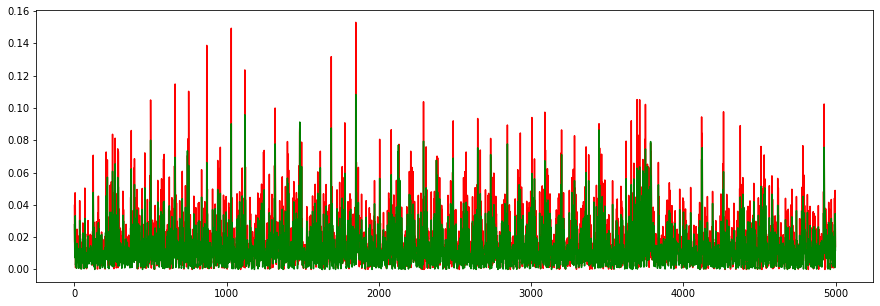

In [ ]:
plt.figure(figsize=(15, 5))
plt.plot(plotting_data[predicted_key_values[0]], 'r')
plt.plot(plotting_data[known_key[0]], 'g')

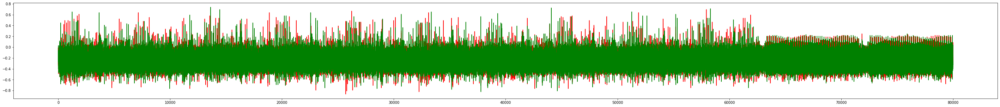

In [ ]:
plt.figure(figsize=(50, 5))
plt.plot(example_shard['traces'][predicted_key_values[0]], 'r')
plt.plot(example_shard['traces'][known_key[0]], 'g')

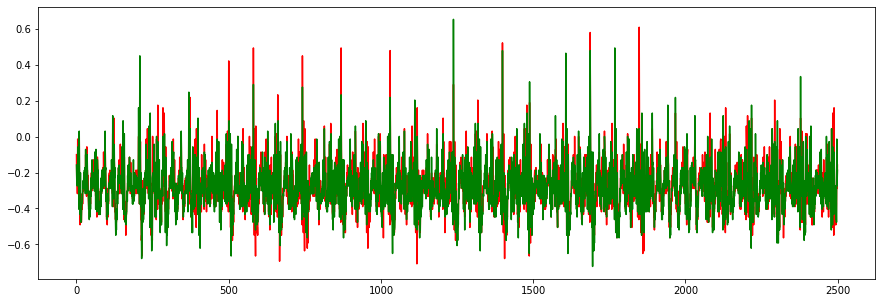

In [ ]:
plt.figure(figsize=(15, 5))
plt.plot(example_shard['traces'][predicted_key_values[0]][:2500], 'r')
plt.plot(example_shard['traces'][known_key[0]][:2500], 'g')

Ocigledno je da dobijeni rezultati nisu jednoznacni i nisu dovoljno precizni. Jedan od razloga za ovo moze biti nedovoljan broj power traceova za jedan kljuc. 

## ASCAD dataset

U [radu](https://eprint.iacr.org/2018/053.pdf) je opisana struktura same baze podataka:
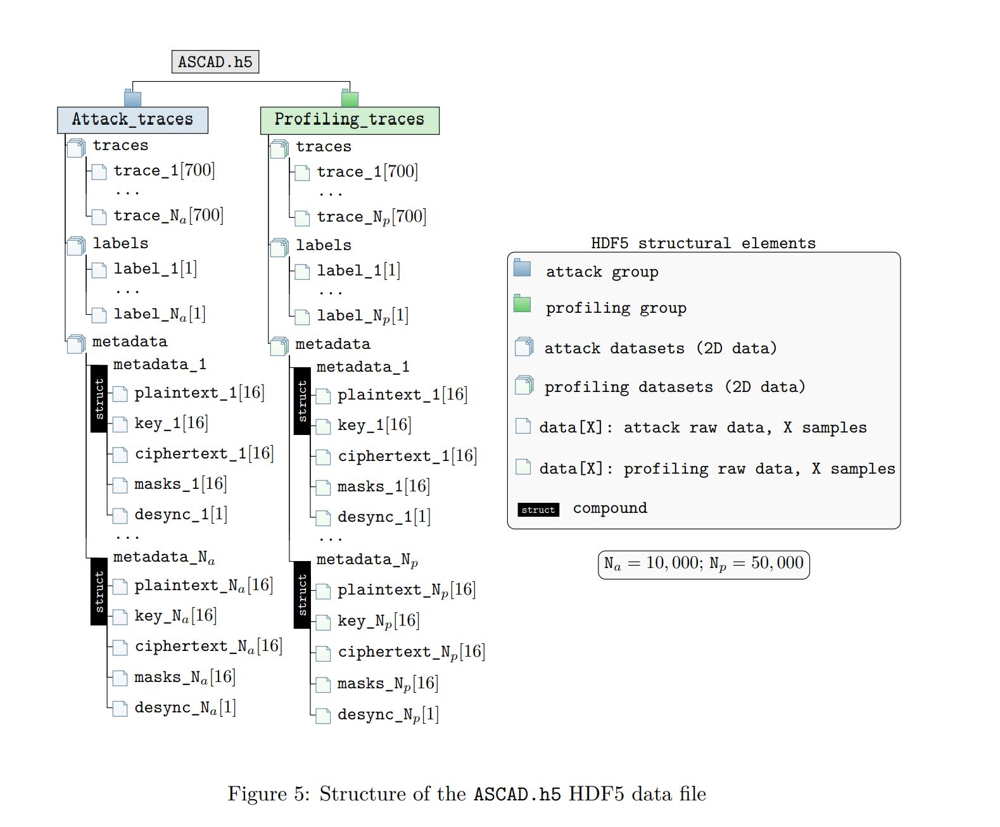

In [11]:
ASCAD_path = "drive/MyDrive/ASCAD_data/ASCAD_databases/ASCAD.h5"

Profiling_traces_group = None
Attack_traces_group = None

ASCAD_hdf = h5py.File(ASCAD_path, "r")

# with h5py.File(ASCAD_path, "r") as ASCAD_hdf:
Profiling_traces_group = ASCAD_hdf.get('Profiling_traces')
print(f"Profiling_traces items: {list(Profiling_traces_group.items())}")
print()
Attack_traces_group = ASCAD_hdf.get('Attack_traces')
print(f"Attack_traces items: {list(Attack_traces_group.items())}")

Profiling_traces items: [('labels', <HDF5 dataset "labels": shape (50000,), type "<i8">), ('metadata', <HDF5 dataset "metadata": shape (50000,), type "|V68">), ('traces', <HDF5 dataset "traces": shape (50000, 700), type "|i1">)]

Attack_traces items: [('labels', <HDF5 dataset "labels": shape (10000,), type "<i8">), ('metadata', <HDF5 dataset "metadata": shape (10000,), type "|V68">), ('traces', <HDF5 dataset "traces": shape (10000, 700), type "|i1">)]


Graph for power trace no. 38722:
Correct class for this trace: 13
plaintext: [154 121  19   4 247 196   9 233  98 225  55 105  55 244  61 128]
ciphertext: [107 178 199  28  49 151 202 184 115 224 215 220 169  25 217  89]
key: [ 77 251 224 242 114  33 254  16 167 141  74 220 142  73   4 105]


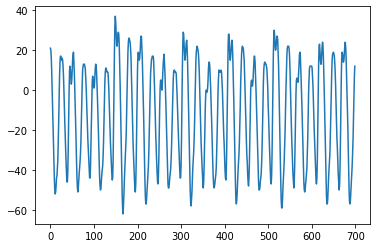

In [ ]:
with h5py.File(ASCAD_path, "r") as ASCAD_hdf:
  Profiling_traces_group = ASCAD_hdf.get('Profiling_traces')

  _traces = Profiling_traces_group.get('traces')
  _labels = Profiling_traces_group.get('labels')
  _metadata = Profiling_traces_group.get('metadata')

  # Plot a random trace
  random_index = random.randint(0, _traces.shape[0] - 1)
  print(f"Graph for power trace no. {random_index}:")
  plt.plot(_traces[random_index])
  print(f"Correct class for this trace: {_labels[random_index]}")
  print(f"plaintext: {_metadata[random_index][0]}")
  print(f"ciphertext: {_metadata[random_index][1]}")
  print(f"key: {_metadata[random_index][2]}")

U ovom skupu podataka su grafovi zumirani na region od interesa za treci bajt kljuca kako bi se smanjio broj ulaznih cvorova u neuronsku mrezu.

For example, in this dataset, everything is tied to this single key: 0, 151, 206, 197, 108, 141, 151, 121, 106, 235,  25,   2, 237, 216, 206, 67

That is for each key byte we have:
* 256 traces
* 256 plain text **bytes**
* 256 cipher text **bytes**
* 256 **bytes** before substitution step (key byte XOR-ed with PT byte)
* 256 **bytes** after substitution step (SBOX applied to XOR-ed value above)

In [ ]:
print("Third key byte:")
print(sampleTrace['keys'][2][0])

print("PT byte coresponding to the third key byte (and the first datapoint)")
print(sampleTrace['pts'][2][0])

print("XOR of the third key byte and PT byte ")
print(sampleTrace['sub_bytes_in'][2][0])

Third key byte:
206
PT byte coresponding to the third key byte (and the first datapoint)
103
XOR of the third key byte and PT byte 
169


If we try to plot the values, we see that the data point resoulution is huge and not much can be seen from the trace. There are some constant values at the end.

The thing is that we don't know if there is an actual data leakage or is it just noise. If the overlayed traces are zoomed in in different intervals, there are some potentially interesting areas. Let's take a look at the fourth byte in the secret key and overlay the different intervals of the traces for it.

In [ ]:
# Check if each trace is for single byte
# If it is, that means that we are using the same approach as in the table (colin video)
for j in range(16):
    print(sampleTrace['keys'][j])

# The assumption was true

"""
    input_byte  key_byte_guess xor_result Sbox_result #of 1's in Sbox_result
        0xC7   |     0x00     |   0xC7   |           |        4
        0x1F   |     0x00     |   0x1F   |           |        2
        0x2C   |     0x00     |   0x2C   |           |        
        0x89   |     0x00     |   0x89   |           |        
        0x01   |     0x00     |   0x01   |           |        
        0xD2   |     0x00     |   0xD2   |           |        
        ...

=> all the traces are for the same key byte, only input text is different
   number of 1's is proportional to the amount of power (larger the spike, 
   larger the number of 1's (Hamming weight))


TODO: zasto 16 inputa samo? Da li je zbog toga sto je CPU 16bitni? Pa onda 
na svakoj zici adresne magistrale imamo jedan input?

https://elie.net/blog/security/hacker-guide-to-deep-learning-side-channel-attacks-the-theory/ (Collecting power traces) => 
za 256 kljuceva imamo po 256 plain text bajtova
1 kljuc(16 bajtova) - 256 PT bajtova
1 bajt kljuca - 16 PT bajtova
"""

NameError: ignored

In [ ]:
fig.savefig('traceExploration_shard_0097cec56c8d97796aeb1902edd8ce43_key_byte_3')

There should be correlation between power consumption and for example, number of ones. That is, if there are a lot of ones, we expect higher power consumption on a data bus.
Attack is basically trying to find the corelation between key guesses and power consumption. The idea is to attack single key byte at the time:


1.  Send couple of bytes to CPU to do encryption (1 byte per data bus)
2.  Guess the key byte and predict the output of the S-box for that particular input (sent_byte XOR guessed_key_byte = hypothetical_output_byte)
3.  Count the number of ones in the output bytes
4.  Inspect the trace and try to correlate number of ones with the power consumption for each point in time (for each sample point in a power trace)
5.  Do this for every key byte guess (0x00 - 0xFF) => 256 guesses




**One neuron per sample in the trace!**

In [ ]:
! ls drive/MyDrive/datasets/tinyaes/train | wc -l

256


# Tradicionalni SCA (template attack)

Ideja kod tradicionalnih template napada na implementaciju algoritama enkripcije jeste da se otkrije korelacija izmedju bajtova kljuca i potrosnje energije na magistralama na plocici. 

Koraci prilikom ovog napada su sledeci: (profilisanje + napad)
Podesavanje osciloskopa da hvata elektricne signale (moze se koristiti i sonda za detekciju elektromagnetnog zracenja) sto blize samom cipu, odnosno messstu na kome se odvija kriptografska operacija.

Slanje razlicitih nasumicnih bajtova cipu kako bi cip obavio enkripciju nad tim bajtovima. 

Merenje potrosnje energije u datom vremenskom periodu.








In [ ]:
!unzip -d drive/MyDrive/ drive/MyDrive/ASCAD_data.zip

In [ ]:
import h5py

filepath = "drive/MyDrive/ASCAD_data/ASCAD_databases/ASCAD.h5"

with h5py.File(filepath, "r") as f:
  print("Keys {}".format(f.keys()))

  profiling_trace_key = list(f.keys())[1]
  profiling_trace_group = f[profiling_trace_key]

  # print(profiling_trace_group.get('traces')[0])
  print(profiling_trace_group.get('labels')[0])
  for mtd in profiling_trace_group.get('metadata')[0]:
    print(mtd)
  for mtd1 in profiling_trace_group.get('metadata')[1]:
    print(mtd1)

  attack_trace_key = list(f.keys())[0]
  attack_trace_group = f[attack_trace_key]
  print("===================================")
  # print(attack_trace_group.get('traces')[0])
  print(attack_trace_group.get('labels')[0])
  for m in attack_trace_group.get('metadata')[0]:
    print(m)
  print("===================================")
  # print(attack_trace_group.get('traces')[1])
  print(attack_trace_group.get('labels')[1])
  for m1 in attack_trace_group.get('metadata')[1]:
    print(m1)

Keys <KeysViewHDF5 ['Attack_traces', 'Profiling_traces']>
<KeysViewHDF5 ['labels', 'metadata', 'traces']>
38
[  6  65 195  66  25 182 248  19 159 132  97   6  46 137  42  16]
[ 95  75 255 146 229  35  24  50  16 107 238  33  93  56 106 178]
[ 77 251 224 242 114  33 254  16 167 141  74 220 142  73   4 105]
[  7  84  71 171 129 171  90 193 236 131  21 112 185  95 212  55]
[0]
[ 64  84 174 122  92 107 179   4 192  55  90 128 132  74 139  27]
[ 23 248 254  14  91 201   8 132  57 212 123  91  91 233 227  72]
[ 77 251 224 242 114  33 254  16 167 141  74 220 142  73   4 105]
[192 166  45  89 164  22 209 144   3 192 239 152 122   7 185  67]
[0]
214
[ 31 172 170 167 237  34 191  94 192 195  85 125 149  46 115 121]
[162  37 213  18 216  58  16  67 197 193 162 176  28  84 140  38]
[ 77 251 224 242 114  33 254  16 167 141  74 220 142  73   4 105]
[161 165 119 180 191 232  52  24 197   7  58  87 180  44  10 121]
[0]
34
[145 254 116 244 139  35  15 167 204  61 154 225  58  66 234 241]
[ 49  97 182 1

Keys <KeysViewHDF5 ['Attack_traces', 'Profiling_traces']>


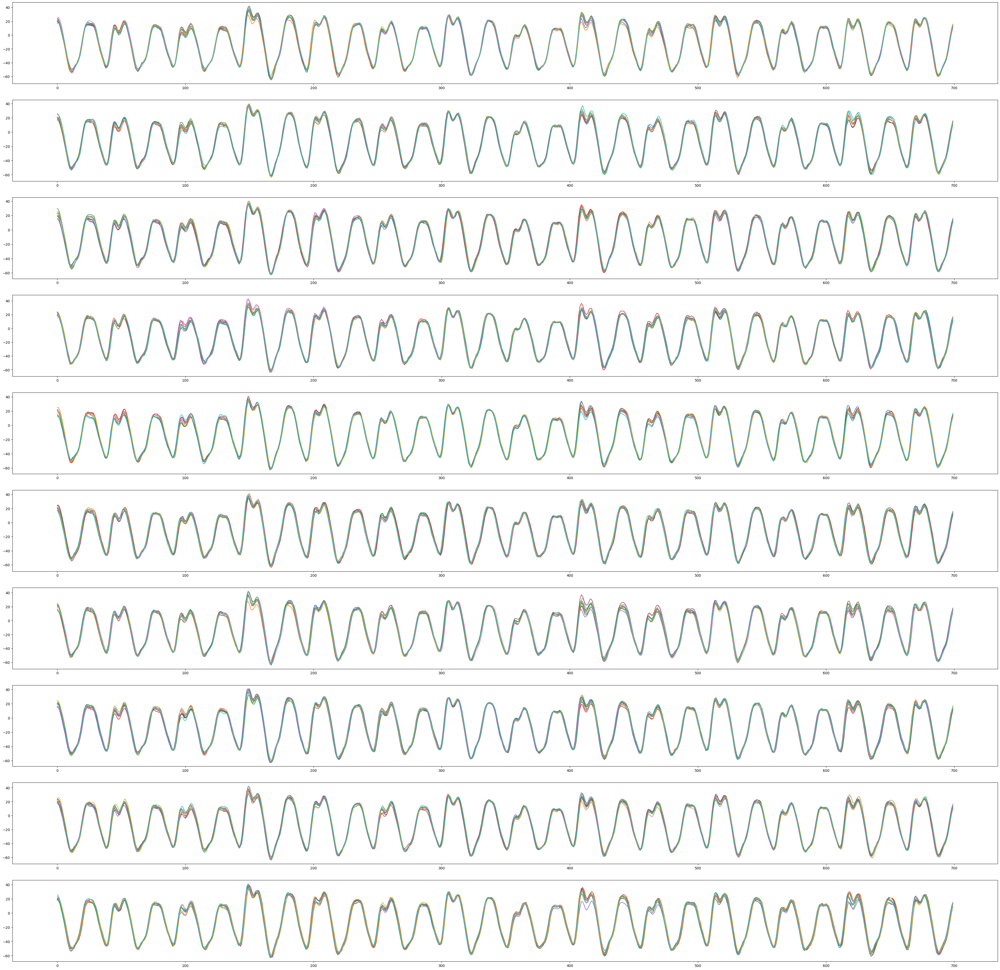

In [ ]:
fig = Figure(figsize=(50,50), dpi=100)
with h5py.File(filepath, "r") as f:

  profiling_trace_key = list(f.keys())[1]
  profiling_trace_group = f[profiling_trace_key]
  for i in range(10):
    ax = fig.add_subplot(10,1,i+1)
    # ax.margins(x=-0.35, y=0)
    for j in range(i*10, i*10 + 10):
      ax.plot(profiling_trace_group.get('traces')[j])

  display(fig)

## Train model on ASCAD db

In [17]:
ASCAD_path = "drive/MyDrive/ASCAD_data/ASCAD_databases/ASCAD.h5"

Profiling_traces_group = None
Attack_traces_group = None

ASCAD_hdf = h5py.File(ASCAD_path, "r")

# with h5py.File(ASCAD_path, "r") as ASCAD_hdf:
Profiling_traces_group = ASCAD_hdf.get('Profiling_traces')
print(f"Profiling_traces items: {list(Profiling_traces_group.items())}")
print()
Attack_traces_group = ASCAD_hdf.get('Attack_traces')
print(f"Attack_traces items: {list(Attack_traces_group.items())}")

Profiling_traces items: [('labels', <HDF5 dataset "labels": shape (50000,), type "<i8">), ('metadata', <HDF5 dataset "metadata": shape (50000,), type "|V68">), ('traces', <HDF5 dataset "traces": shape (50000, 700), type "|i1">)]

Attack_traces items: [('labels', <HDF5 dataset "labels": shape (10000,), type "<i8">), ('metadata', <HDF5 dataset "metadata": shape (10000,), type "|V68">), ('traces', <HDF5 dataset "traces": shape (10000, 700), type "|i1">)]


In [18]:
def create_data(training, num_traces=None, trace_length=700, return_metadata=True ):
        
  traces = Profiling_traces_group.get('traces') if training else Attack_traces_group.get('traces')
  labels = Profiling_traces_group.get('labels') if training else Attack_traces_group.get('labels')
  metadata = Profiling_traces_group.get('metadata') if training else Attack_traces_group.get('metadata')
  if num_traces is None:
          num_traces = traces.shape[0]
  X = tf.convert_to_tensor(traces[:num_traces, :trace_length])
  y = tf.convert_to_tensor(tf.keras.utils.to_categorical(labels[:num_traces], num_classes=256))
  
  if return_metadata != True:
      metadata = None
  return ((X,y), metadata)

In [19]:
(X_train, y_train), train_metadata = create_data(training=True)
(X_test, y_test), test_metadata = create_data(training=False)

In [20]:
input_vector_shape = X_train.shape[1]

## [Functional Keras API]

### Define model

In [12]:
# Input
inputs = keras.Input(shape = (input_vector_shape,))

# Hidden layer 1
x = keras.layers.Dense(name='hidden_layer_1', units=200, activation='relu')(inputs)

# Hidden layer 2
x = keras.layers.Dense(name='hidden_layer_2', units=200, activation='relu')(x)

# Batch normalization layer
# x = keras.layers.BatchNormalization(name='batch_norm_1')(x)

# Hidden layer 3
x = keras.layers.Dense(name='hidden_layer_3', units=200, activation='relu')(x)

# Hidden layer 4
x = keras.layers.Dense(name='hidden_layer_4', units=200, activation='relu')(x)

# Batch normalization layer
# x = keras.layers.BatchNormalization(name='batch_norm_2')(x)

# Hidden layer 5
x = keras.layers.Dense(name='hidden_layer_5', units=200, activation='relu')(x)

# Output layer
outputs = keras.layers.Dense(name='output_layer', units=256, activation='softmax')(x)

MLP = keras.Model(inputs=inputs, outputs=outputs, name='functional_MLP')

In [13]:
MLP.summary()

Model: "functional_MLP"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 700)]             0         
                                                                 
 hidden_layer_1 (Dense)      (None, 200)               140200    
                                                                 
 hidden_layer_2 (Dense)      (None, 200)               40200     
                                                                 
 hidden_layer_3 (Dense)      (None, 200)               40200     
                                                                 
 hidden_layer_4 (Dense)      (None, 200)               40200     
                                                                 
 hidden_layer_5 (Dense)      (None, 200)               40200     
                                                                 
 output_layer (Dense)        (None, 256)            

### Compile and train the model

In [14]:
MLP_optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.00001)

MLP.compile(loss='categorical_crossentropy', 
                 optimizer=MLP_optimizer, 
                 metrics=['accuracy'])

In [35]:
_log_dir = '/content/drive/MyDrive/logs/' + 'MLP_' + datetime.now().strftime("%Y-%d-%m_%H-%M")

callbacks_list = [
    tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3),
    tf.keras.callbacks.TensorBoard(log_dir=_log_dir, histogram_freq=1)
]

# history = MLP.fit(X_train,y_train,batch_size=32,epochs=50,verbose=1,validation_split=0.2, callbacks=callbacks_list)
history = MLP.fit(X_train,y_train,batch_size=32,epochs=50,verbose=1,validation_data=(X_test, y_test), callbacks=callbacks_list)

Epoch 1/50
1563/1563 [==============================] - 17s 10ms/step - loss: 5.5252 - accuracy: 0.0069 - val_loss: 5.5643 - val_accuracy: 0.0048
Epoch 2/50
1563/1563 [==============================] - 12s 8ms/step - loss: 5.5239 - accuracy: 0.0073 - val_loss: 5.5625 - val_accuracy: 0.0038
Epoch 3/50
1563/1563 [==============================] - 12s 8ms/step - loss: 5.5226 - accuracy: 0.0070 - val_loss: 5.5628 - val_accuracy: 0.0040
Epoch 4/50
1563/1563 [==============================] - 13s 8ms/step - loss: 5.5213 - accuracy: 0.0072 - val_loss: 5.5633 - val_accuracy: 0.0034
Epoch 5/50
1563/1563 [==============================] - 12s 8ms/step - loss: 5.5200 - accuracy: 0.0075 - val_loss: 5.5642 - val_accuracy: 0.0044
Epoch 6/50
1563/1563 [==============================] - 13s 8ms/step - loss: 5.5189 - accuracy: 0.0071 - val_loss: 5.5599 - val_accuracy: 0.0047
Epoch 7/50
1563/1563 [==============================] - 12s 8ms/step - loss: 5.5180 - accuracy: 0.0068 - val_loss: 5.5651 - val_a

### Evaluate model

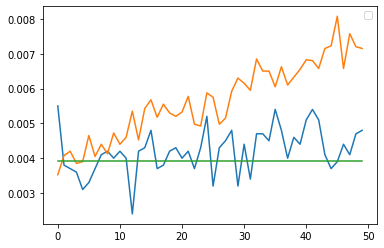

In [29]:
random_accuracy = [1/256] * len(history.history['val_accuracy'])

plt.plot(history.history['val_accuracy'])
plt.plot(history.history['accuracy'])
plt.plot(random_accuracy)
plt.legend(['val_acc', 'acc', 'random'],loc='best')
plt.show()

Model je uspeo da dostigne blago bolje rezultate od nasumicnog pogadjanja (sto bi trebalo da bude dovoljno dobro za rekonstrukciju kljuca) []()

Napad se odnosio na izlaz iz SBOX dela AES algoritma, te za napad na sam kljuc moramo uraditi inverznu operaciju.

In [109]:
target_pt = np.array(test_metadata['plaintext'][:, 2])
target_ct = np.array(test_metadata['ciphertext'][:, 2])

In [165]:
max_occurence = data.most_common(1)[0][1]

In [172]:
test_metadata[0]['key']

array([ 77, 251, 224, 242, 114,  33, 254,  16, 167, 141,  74, 220, 142,
        73,   4, 105], dtype=uint8)

In [127]:
predictions = MLP_BatchNorm.predict(X_test)
sbox_out_predicted = np.array(np.argmax(predictions, axis=1), dtype='uint8')

aes = AES()

key_predictions = []
for s, t in zip(sbox_out_predicted, target_pt):
  key_predictions.append(aes.reverse_aes(s, t))

print(sorted(key_predictions))
print(np.sum(np.asarray(key_predictions) == test_metadata['key'][0][2]))

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 8, 

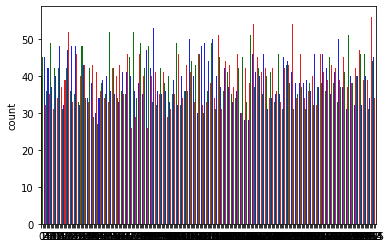

In [167]:
import seaborn as sns
sns.countplot(x=key_predictions, palette=['r', 'g', 'b'])

In [129]:
from collections import Counter
data = Counter(key_predictions)
print(test_metadata['key'])
print(data.most_common())   # Returns all unique items and their counts
print(data.most_common(1))  # Returns the highest occurring item

[[ 77 251 224 ...  73   4 105]
 [ 77 251 224 ...  73   4 105]
 [ 77 251 224 ...  73   4 105]
 ...
 [ 77 251 224 ...  73   4 105]
 [ 77 251 224 ...  73   4 105]
 [ 77 251 224 ...  73   4 105]]
[(252, 56), (162, 54), (192, 54), (86, 53), (52, 52), (21, 52), (70, 52), (235, 51), (135, 51), (160, 51), (131, 50), (113, 50), (227, 50), (130, 49), (125, 49), (76, 49), (7, 49), (103, 49), (31, 48), (82, 48), (14, 48), (122, 48), (26, 48), (23, 48), (80, 47), (20, 47), (243, 47), (66, 46), (198, 46), (170, 46), (215, 46), (27, 46), (213, 46), (150, 46), (121, 46), (161, 46), (247, 46), (209, 46), (244, 46), (120, 46), (75, 46), (105, 46), (181, 46), (67, 45), (2, 45), (165, 45), (154, 45), (231, 45), (1, 45), (185, 45), (220, 45), (136, 45), (254, 45), (128, 44), (141, 44), (115, 44), (188, 44), (253, 44), (187, 43), (222, 43), (33, 43), (118, 43), (32, 43), (39, 43), (189, 43), (144, 43), (60, 43), (111, 43), (240, 42), (177, 42), (55, 42), (54, 42), (83, 42), (166, 42), (5, 42), (218, 42), (1

### Model with batch normalization

In [32]:
# Input
inputs = keras.Input(shape = (input_vector_shape,))

# Hidden layer 1
x = keras.layers.Dense(name='hidden_layer_1', units=200, activation='relu')(inputs)

# Hidden layer 2
x = keras.layers.Dense(name='hidden_layer_2', units=200, activation='relu')(x)

# Batch normalization layer
x = keras.layers.BatchNormalization(name='batch_norm_1')(x)

# Hidden layer 3
x = keras.layers.Dense(name='hidden_layer_3', units=200, activation='relu')(x)

# Hidden layer 4
x = keras.layers.Dense(name='hidden_layer_4', units=200, activation='relu')(x)

# Batch normalization layer
x = keras.layers.BatchNormalization(name='batch_norm_2')(x)

# Hidden layer 5
x = keras.layers.Dense(name='hidden_layer_5', units=200, activation='relu')(x)

# Output layer
outputs = keras.layers.Dense(name='output_layer', units=256, activation='softmax')(x)

MLP_BatchNorm = keras.Model(inputs=inputs, outputs=outputs, name='functional_MLP_BatchNorm')

In [33]:
MLP_BatchNorm.summary()

Model: "functional_MLP_BatchNorm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 700)]             0         
                                                                 
 hidden_layer_1 (Dense)      (None, 200)               140200    
                                                                 
 hidden_layer_2 (Dense)      (None, 200)               40200     
                                                                 
 batch_norm_1 (BatchNormaliz  (None, 200)              800       
 ation)                                                          
                                                                 
 hidden_layer_3 (Dense)      (None, 200)               40200     
                                                                 
 hidden_layer_4 (Dense)      (None, 200)               40200     
                                          

In [34]:
MLP_optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.00001)

MLP_BatchNorm.compile(loss='categorical_crossentropy', 
                 optimizer=MLP_optimizer, 
                 metrics=['accuracy'])

In [47]:
def train_model(model, X_train, y_train, batch_size, epochs, validation_data, callbacks_list=None, nn_type='MLP', tag='', save_dir=None):
  
  _date = datetime.now().strftime("%Y-%d-%m_%H-%M")

  _save_dir = '/content/drive/MyDrive/models/' + save_dir + '_' + _date + '[' + tag + ']' 
  _log_dir =  '/content/drive/MyDrive/logs/' + nn_type + '_' + _date + '[' + tag + ']'

  if callbacks_list is None:
    callbacks_list = [
      tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3),
      tf.keras.callbacks.TensorBoard(log_dir=_log_dir, histogram_freq=1)
    ]

  history = model.fit(X_train, y_train, batch_size=batch_size,epochs=epochs,verbose=1,validation_data=validation_data, callbacks=callbacks_list)

  model.save(_save_dir)

  return history

In [37]:
train_model(MLP_BatchNorm, X_train, y_train, batch_size=32, epochs=50, validation_data=(X_test, y_test), tag='BatchNorm')

Epoch 1/50
1563/1563 [==============================] - 14s 9ms/step - loss: 5.4246 - accuracy: 0.0123 - val_loss: 5.5578 - val_accuracy: 0.0064
Epoch 2/50
1563/1563 [==============================] - 14s 9ms/step - loss: 5.4210 - accuracy: 0.0123 - val_loss: 5.5525 - val_accuracy: 0.0070
Epoch 3/50
1563/1563 [==============================] - 14s 9ms/step - loss: 5.4188 - accuracy: 0.0125 - val_loss: 5.5621 - val_accuracy: 0.0069
Epoch 4/50
1563/1563 [==============================] - 14s 9ms/step - loss: 5.4154 - accuracy: 0.0129 - val_loss: 5.5493 - val_accuracy: 0.0068
Epoch 5/50
1563/1563 [==============================] - 14s 9ms/step - loss: 5.4119 - accuracy: 0.0126 - val_loss: 5.5497 - val_accuracy: 0.0074
Epoch 6/50
1563/1563 [==============================] - 14s 9ms/step - loss: 5.4092 - accuracy: 0.0129 - val_loss: 5.5571 - val_accuracy: 0.0068
Epoch 7/50
1563/1563 [==============================] - 14s 9ms/step - loss: 5.4059 - accuracy: 0.0131 - val_loss: 5.5562 - val_ac

### Hypertuning

In [15]:
min_layers = 4
max_layers = 10

min_units = 50
max_units = 1000

def build_model(hp):
    
    inputs = keras.Input(shape = (input_vector_shape,))
    
    x = inputs
    
    no_layers = hp.Int('num_layers', min_value=min_layers, max_value=max_layers)
    for layer in range(no_layers):
        
        x = keras.layers.Dense(units = hp.Int('units', min_value=min_units, max_value=max_units, step=50),
                               activation = 'relu')(x)
        
        # Optimize for batch normalization
        if layer == int(no_layers/2) and hp.Boolean('BatchNormalize'):
            x = keras.layers.BatchNormalization()(x)
        

    outputs = keras.layers.Dense(units=256, activation='softmax')(x)
    # Tune the learning rate for the optimizer
    # Choose an optimal value from 0.01, 0.001, or 0.0001
    hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4, 1e-5, 3e-2, 3e-3, 3e-4, 3e-5, 5e-2, 5e-3, 5e-4, 5e-5])
#     hp_learning_rate = hp.Float("lr", min_value=1e-5, max_value=1e-2, sampling="log")

    model = keras.Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=hp_learning_rate),
                    loss="categorical_crossentropy",
                    metrics=['accuracy',
                             'Recall'])

    return model

In [32]:
tuner = kt.RandomSearch(hypermodel=build_model,
                    objective='val_accuracy',
                    max_trials=75,
                    executions_per_trial=1,
                    directory='/content/drive/MyDrive/logs/hyperparam_tuning',
                    project_name='MLP_SCA_1.0_colab')

tuner.search_space_summary()

Search space summary
Default search space size: 4
num_layers (Int)
{'default': None, 'conditions': [], 'min_value': 4, 'max_value': 10, 'step': 1, 'sampling': None}
units (Int)
{'default': None, 'conditions': [], 'min_value': 50, 'max_value': 1000, 'step': 50, 'sampling': None}
BatchNormalize (Boolean)
{'default': False, 'conditions': []}
learning_rate (Choice)
{'default': 0.01, 'conditions': [], 'values': [0.01, 0.001, 0.0001, 1e-05, 0.03, 0.003, 0.0003, 3e-05, 0.05, 0.005, 0.0005, 5e-05], 'ordered': True}


In [48]:
h_tuner = kt.Hyperband(
    hypermodel=build_model,
    objective='val_accuracy',
    max_epochs=75,
    hyperband_iterations=10,
    directory='/content/drive/MyDrive/logs/hyperparam_tuning',
    project_name='MLP_SCA_1.0_colab_hyperband'
)

h_tuner.search_space_summary()

Search space summary
Default search space size: 4
num_layers (Int)
{'default': None, 'conditions': [], 'min_value': 4, 'max_value': 10, 'step': 1, 'sampling': None}
units (Int)
{'default': None, 'conditions': [], 'min_value': 50, 'max_value': 1000, 'step': 50, 'sampling': None}
BatchNormalize (Boolean)
{'default': False, 'conditions': []}
learning_rate (Choice)
{'default': 0.01, 'conditions': [], 'values': [0.01, 0.001, 0.0001, 1e-05, 0.03, 0.003, 0.0003, 3e-05, 0.05, 0.005, 0.0005, 5e-05], 'ordered': True}


In [ ]:
tensorboard_path  = "/content/drive/MyDrive/logs/hyperparam_tuning/MLP_RandomSearch"
intermediate_path = "/content/drive/MyDrive/logs/hyperparam_tuning/MLP_RandomSearch/tmp"

early_stop_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=2)
tensorboard_callback = tf.keras.callbacks.TensorBoard(tensorboard_path)

tuner.search(X_train, 
             y_train, 
             epochs=10, 
             validation_data=(X_test, y_test), 
             callbacks=[early_stop_callback,
                       tensorboard_callback]
            )

In [ ]:
tensorboard_path  = "/content/drive/MyDrive/logs/hyperparam_tuning/MLP_Hyperband"
intermediate_path = "/content/drive/MyDrive/logs/hyperparam_tuning/MLP_Hyperband/tmp"

early_stop_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=2)
tensorboard_callback = tf.keras.callbacks.TensorBoard(tensorboard_path)

h_tuner.search(X_train, 
             y_train, 
             epochs=10, 
             validation_data=(X_test, y_test), 
             callbacks=[early_stop_callback,
                       tensorboard_callback]
            )

Trial 73 Complete [00h 22m 24s]
val_accuracy: 0.007199999876320362

Best val_accuracy So Far: 0.007199999876320362
Total elapsed time: 05h 48m 13s

Search: Running Trial #74

Value             |Best Value So Far |Hyperparameter
4                 |6                 |num_layers
950               |350               |units
True              |True              |BatchNormalize
1e-05             |3e-05             |learning_rate
75                |75                |tuner/epochs
25                |25                |tuner/initial_epoch
2                 |2                 |tuner/bracket
2                 |2                 |tuner/round
0069              |0068              |tuner/trial_id

Epoch 26/75
1563/1563 [==============================] - 78s 49ms/step - loss: 5.6293 - accuracy: 0.0045 - recall: 0.0000e+00 - val_loss: 5.6531 - val_accuracy: 0.0035 - val_recall: 0.0000e+00
Epoch 27/75
1563/1563 [==============================] - 76s 49ms/step - loss: 5.5674 - accuracy: 0.0046 - recall: 0

### Visualize trainings with tensorboard

In [3]:
%load_ext tensorboard

In [7]:
%tensorboard --logdir /content/drive/MyDrive/logs/hyperparam_tuning/MLP_Hyperband/

Reusing TensorBoard on port 6007 (pid 358), started 0:05:42 ago. (Use '!kill 358' to kill it.)

<IPython.core.display.Javascript object>

In [43]:
# Reload best hyper parameters
h_tuner = kt.Hyperband(
    hypermodel=build_model,
    objective='val_accuracy',
    max_epochs=75,
    hyperband_iterations=10,
    directory='/content/drive/MyDrive/logs/hyperparam_tuning',
    project_name='MLP_SCA_1.0_colab_hyperband'
)

h_tuner.search_space_summary()

Search space summary
Default search space size: 4
num_layers (Int)
{'default': None, 'conditions': [], 'min_value': 4, 'max_value': 10, 'step': 1, 'sampling': None}
units (Int)
{'default': None, 'conditions': [], 'min_value': 50, 'max_value': 1000, 'step': 50, 'sampling': None}
BatchNormalize (Boolean)
{'default': False, 'conditions': []}
learning_rate (Choice)
{'default': 0.01, 'conditions': [], 'values': [0.01, 0.001, 0.0001, 1e-05, 0.03, 0.003, 0.0003, 3e-05, 0.05, 0.005, 0.0005, 5e-05], 'ordered': True}


In [44]:
print(h_tuner.get_best_hyperparameters()[0].values)
print("===========================================")
h_tuner.results_summary()

{'num_layers': 6, 'units': 350, 'BatchNormalize': True, 'learning_rate': 3e-05, 'tuner/epochs': 75, 'tuner/initial_epoch': 25, 'tuner/bracket': 2, 'tuner/round': 2, 'tuner/trial_id': '0068'}
Results summary
Results in /content/drive/MyDrive/logs/hyperparam_tuning/MLP_SCA_1.0_colab_hyperband
Showing 10 best trials
Trial summary
Hyperparameters:
num_layers: 6
units: 350
BatchNormalize: True
learning_rate: 3e-05
tuner/epochs: 75
tuner/initial_epoch: 25
tuner/bracket: 2
tuner/round: 2
tuner/trial_id: 0068
Score: 0.007199999876320362
Trial summary
Hyperparameters:
num_layers: 5
units: 600
BatchNormalize: True
learning_rate: 5e-05
tuner/epochs: 75
tuner/initial_epoch: 25
tuner/bracket: 3
tuner/round: 3
tuner/trial_id: 0048
Score: 0.006899999920278788
Trial summary
Hyperparameters:
num_layers: 5
units: 600
BatchNormalize: True
learning_rate: 5e-05
tuner/epochs: 25
tuner/initial_epoch: 9
tuner/bracket: 3
tuner/round: 2
tuner/trial_id: 0044
Score: 0.006200000178068876
Trial summary
Hyperparamet

---
### Architecture from ASCAD paper 

In this section architecture from [ASCAD paper](https://eprint.iacr.org/2018/053.pdf 'ASCAD paper') will be tested.

------------------------------

In [10]:
	ASCAD_MLP = keras.Sequential()
	ASCAD_MLP.add(keras.layers.Dense(200, input_dim=700, activation='relu'))
	for i in range(4):
		ASCAD_MLP.add(keras.layers.Dense(200, activation='relu'))
	ASCAD_MLP.add(keras.layers.Dense(256, activation='softmax'))
	optimizer = tf.keras.optimizers.RMSprop(lr=0.00001)
	ASCAD_MLP.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


In [46]:
ASCAD_history = train_model(ASCAD_MLP, X_train, y_train, batch_size=200, epochs=75, validation_data=(X_test, y_test), tag='ASCAD')

NameError: ignored

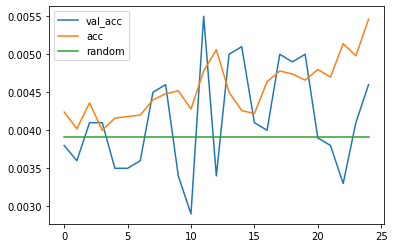

In [21]:
random_accuracy = [1/256] * len(ASCAD_history.history['val_accuracy'])

plt.plot(ASCAD_history.history['val_accuracy'])
plt.plot(ASCAD_history.history['accuracy'])
plt.plot(random_accuracy)
plt.legend(['val_acc', 'acc', 'random'],loc='best')
plt.show()

In [27]:
predictions = ASCAD_MLP.predict(X_test)
sbox_out_predicted = np.array(np.argmax(predictions, axis=1), dtype='uint8')
target_pt = np.array(test_metadata['plaintext'][:, 2])
target_ct = np.array(test_metadata['ciphertext'][:, 2])

aes = AES()

key_predictions = []
for s, t in zip(sbox_out_predicted, target_pt):
  key_predictions.append(aes.reverse_aes(s, t))

print(sorted(key_predictions))
print(np.sum(np.asarray(key_predictions) == test_metadata['key'][0][2]))

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 

In [45]:
from collections import Counter
data = Counter(key_predictions)
print(test_metadata['key'][0][2])
print(data.most_common())   # Returns all unique items and their counts
print(data.most_common(1))  # Returns the highest occurring item

NameError: ignored

## Train and evaluate on SCAAML dataset

In [49]:
best_mlp_config = {'num_layers': 6, 
                   'units': 350, 
                   'BatchNormalize': True, 
                   'learning_rate': 3e-05, 
                   'epochs': 75}

In [50]:
def build_model_from_config(config):
    
    inputs = keras.Input(shape = (input_vector_shape,))
    
    x = inputs
    
    no_layers = config['num_layers']
    for layer in range(no_layers):
        
        x = keras.layers.Dense(units = config['units'], activation = 'relu')(x)
        
        # Optimize for batch normalization
        if layer == int(no_layers/2) and config['BatchNormalize']:
            x = keras.layers.BatchNormalization()(x)
        

    outputs = keras.layers.Dense(units=256, activation='softmax')(x)
    
    learning_rate = config['learning_rate']

    model = keras.Model(inputs=inputs, outputs=outputs)

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                    loss="categorical_crossentropy",
                    metrics=['accuracy',
                             'Recall'])

    return model

### SCAAML data utilities

In [53]:
training_data_path = '/content/drive/MyDrive/datasets/tinyaes/train'
testing_data_path = '/content/drive/MyDrive/datasets/tinyaes/test'

In [52]:
def load_shards(path, num_shards=256):
    shard_array = []
    for shard_idx, shard_name in tqdm(enumerate(os.listdir(path))):
        if shard_idx == num_shards:
            break
        shard_array.append(np.load(path + '/' + shard_name))

    return shard_array

In [60]:
training_data = load_shards(training_data_path, 256)
testing_data = load_shards(testing_data_path, 256)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

In [83]:
DEFAULT_TRACE_LENGTH = 80000

def create_data(shard_array, attack_point, attack_byte, trace_length=DEFAULT_TRACE_LENGTH):
    X = []
    y = []
    
    for shard in tqdm(shard_array, desc='Loading shards', position=0, leave=True):
        X.append(tf.convert_to_tensor(shard['traces'][:,:trace_length,:], dtype='float32'))
        
        y_ = shard[attack_point][attack_byte]
        y_ = keras.utils.np_utils.to_categorical(y_, num_classes=256, dtype='uint8')
        
        y.append(tf.convert_to_tensor(y_))
        
    X = tf.concat(X, axis=0)
    y = tf.concat(y, axis=0)

    indices = tf.range(start=0, limit=tf.shape(X)[0], dtype=tf.int32)
    shuffled_indices = tf.random.shuffle(indices)

    X = tf.gather(X, shuffled_indices)
    y = tf.gather(y, shuffled_indices)
        
    return (X, y)

In [ ]:
(X_train_scaaml, y_train_scaaml) = create_data(training_data, 'sub_bytes_out', 0, 5000)
(X_test_scaaml, y_test_scaaml) = create_data(testing_data, 'sub_bytes_out', 0, 5000)

Loading shards:   0%|          | 0/256 [00:00<?, ?it/s]

Loading shards:   0%|          | 0/256 [00:00<?, ?it/s]

In [64]:
X_train_scaaml

<tf.Tensor: shape=(65536, 10000, 1), dtype=float32, numpy=
array([[[-0.10058594],
        [-0.2163086 ],
        [-0.24511719],
        ...,
        [-0.38964844],
        [-0.5776367 ],
        [ 0.03027344]],

       [[-0.18701172],
        [-0.24511719],
        [-0.28857422],
        ...,
        [-0.3173828 ],
        [-0.51953125],
        [ 0.18945312]],

       [[-0.3461914 ],
        [-0.10058594],
        [-0.27392578],
        ...,
        [-0.49072266],
        [-0.4477539 ],
        [-0.33203125]],

       ...,

       [[-0.40429688],
        [-0.24511719],
        [-0.27392578],
        ...,
        [-0.27392578],
        [-0.46191406],
        [ 0.5214844 ]],

       [[-0.28857422],
        [-0.18701172],
        [-0.28857422],
        ...,
        [-0.4765625 ],
        [-0.5776367 ],
        [ 0.18945312]],

       [[-0.10058594],
        [-0.27392578],
        [-0.2163086 ],
        ...,
        [-0.375     ],
        [-0.46191406],
        [ 0.16015625]]], dtype=floa

In [51]:
SCAML_base_MLP = build_model_from_config(best_mlp_config)

In [ ]:
# Start tensorboard before training

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/logs/

In [ ]:
# def train_model(model, X_train, y_train, batch_size, epochs, validation_data, callbacks_list=None, nn_type='MLP', tag='', save_dir=None):
train_model(SCAML_base_MLP, X_train=X_train_scaaml, y_train=y_train_scaaml, batch_size=200, epochs=75, validation_data=(X_test_scaaml, y_test_scaaml), tag='SCAAML')